# Plot single-cell RNA seq dataset

@Siqi Du

Paper:
A single-cell molecular map of mouse gastrulation and early organogenesis

Species:
mouse

Stage:
E6.5-E8.5 (gastrulation and early organogenesis when pluripotent epiblast cells diversify into ectodermal, mesodermal and endodermal progenitors of all major organs)

Goal:
Plot data for my AP micrcopatterns paper

In [1]:
import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import scvi
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import matplotlib.colors as mcolors
from pathlib import Path
base_dir = Path("/Users/dududu/Library/CloudStorage/Box-Box/Siqi/scRNAseq")

/opt/homebrew/envs/rnaseq/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/opt/homebrew/envs/rnaseq/lib/python3.10/site-packages/docrep/decorators.py:43: SyntaxWarning: 'param_categorical_covariate_keys' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/opt/homebrew/envs/rnaseq/lib/python3.10/site-packages/docrep/decorators.py:43: SyntaxWarning: 'param_continuous_covariate_keys' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)


## Plot with 5 cell groups

In [2]:
# import saved scvi normalized data
saved_file = base_dir / "Pijuan-Sala2019_mouse_atlas/data/scvi_v2_neural_ap5.hda5"
adata = anndata.read_h5ad(saved_file)

In [3]:
# umap plot - celltype and stage
sc.tl.umap(adata,spread=0.5,min_dist=0.8)

In [4]:
adata.obsm["X_umap"][:, 0] *= -1 # flip X axis
adata.obsm["X_umap"][:, 1] *= -1 # Flip Y axis

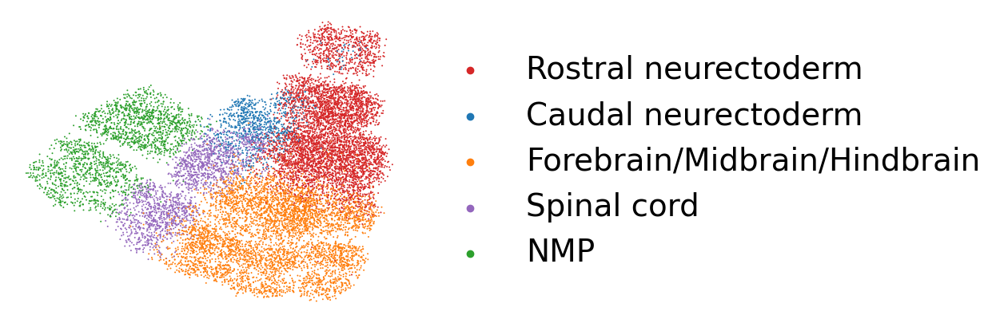

In [5]:
sc.settings.figdir = base_dir / "APmicropatterns"
celltypes = ["Rostral neurectoderm", "Caudal neurectoderm", "Forebrain/Midbrain/Hindbrain",
             "Spinal cord", "NMP"]
adata.obs["celltypes_ordered"] = pd.Categorical(
    values=adata.obs["celltype"], categories=celltypes, ordered=True
)
adata.uns["celltypes_ordered_colors"] = ["#d62728","#1f77b4","#ff7f0e","#9467bd","#2ca02c"]

fig, ax = plt.subplots(figsize=(6.5, 5))
sc.pl.umap(adata,color="celltypes_ordered", 
           title="",
           legend_fontsize=28,
           save="-celltype.png",
           frameon=False, ax=ax)

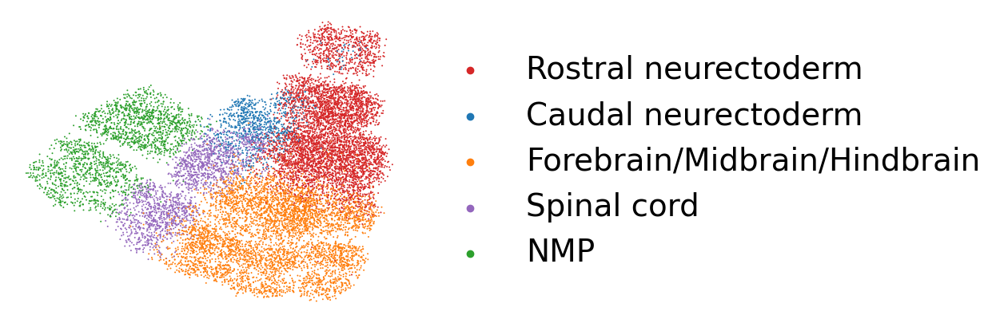

In [6]:
fig, ax = plt.subplots(figsize=(6.5, 5))
sc.pl.umap(adata,color="celltypes_ordered", 
           title="",
           legend_fontsize=28,
           save="-celltype.svg",
           frameon=False, ax=ax)

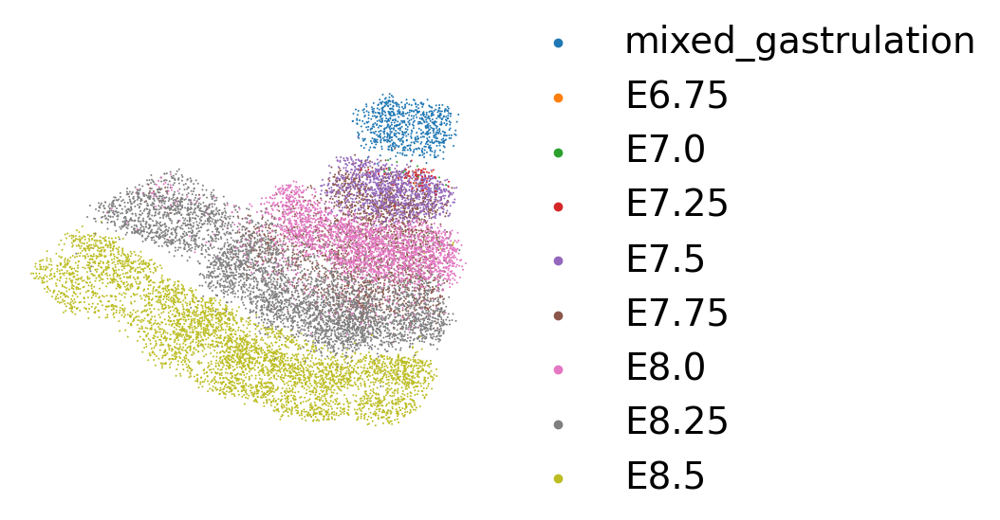

In [7]:
stages = ["mixed_gastrulation", "E6.75", "E7.0","E7.25", "E7.5","E7.75","E8.0","E8.25","E8.5"]
adata.obs["stages_ordered"] = pd.Categorical(
    values=adata.obs["stage"], categories=stages, ordered=True
)

fig, ax = plt.subplots(figsize=(6.5, 5))
ax = sc.pl.umap(adata,color="stages_ordered",
                title="",
                legend_fontsize=28,
                save="-stage.png",
                frameon=False, 
                ax=ax)

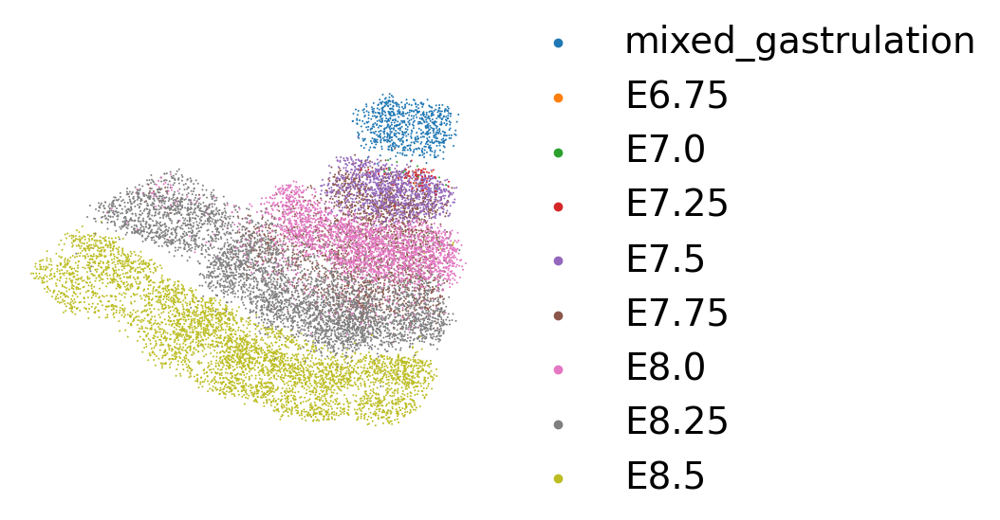

In [8]:
fig, ax = plt.subplots(figsize=(6.5, 5))
ax = sc.pl.umap(adata,color="stages_ordered",
                title="",
                legend_fontsize=28,
                save="-stage.svg",
                frameon=False, 
                ax=ax)

In [9]:
# umap plot - cell fate marker dynamics
sc.tl.umap(adata,spread=0.5,min_dist=0.8)
adata.obsm["X_umap"][:, 0] *= -1 # flip X axis
adata.obsm["X_umap"][:, 1] *= -1 # Flip Y axis

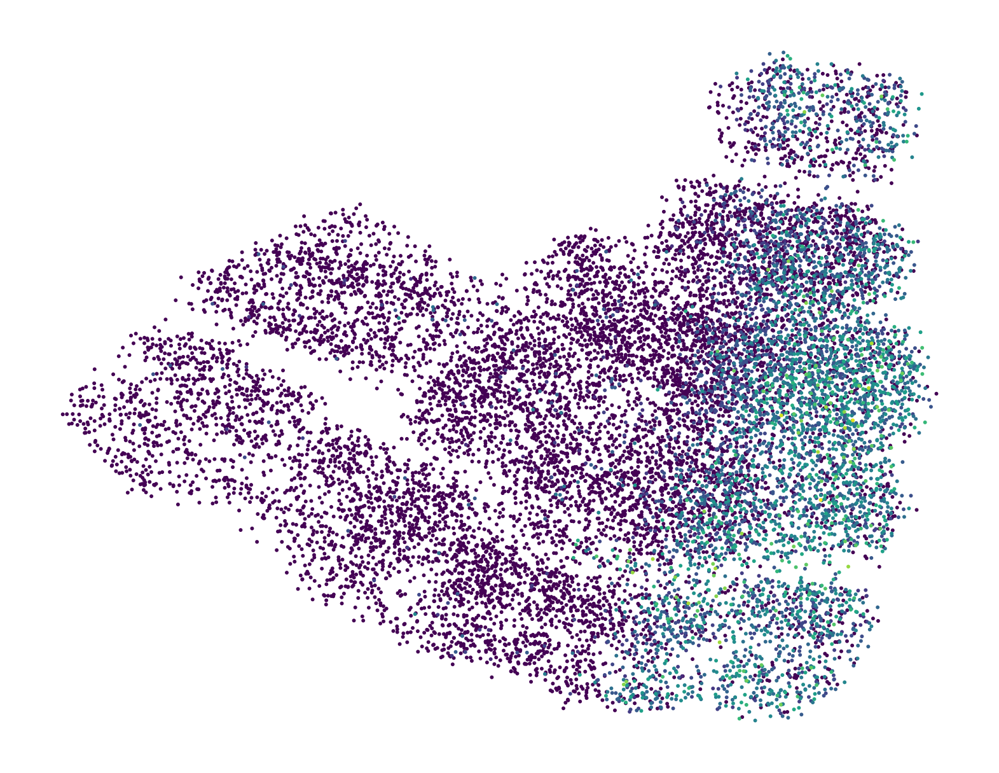

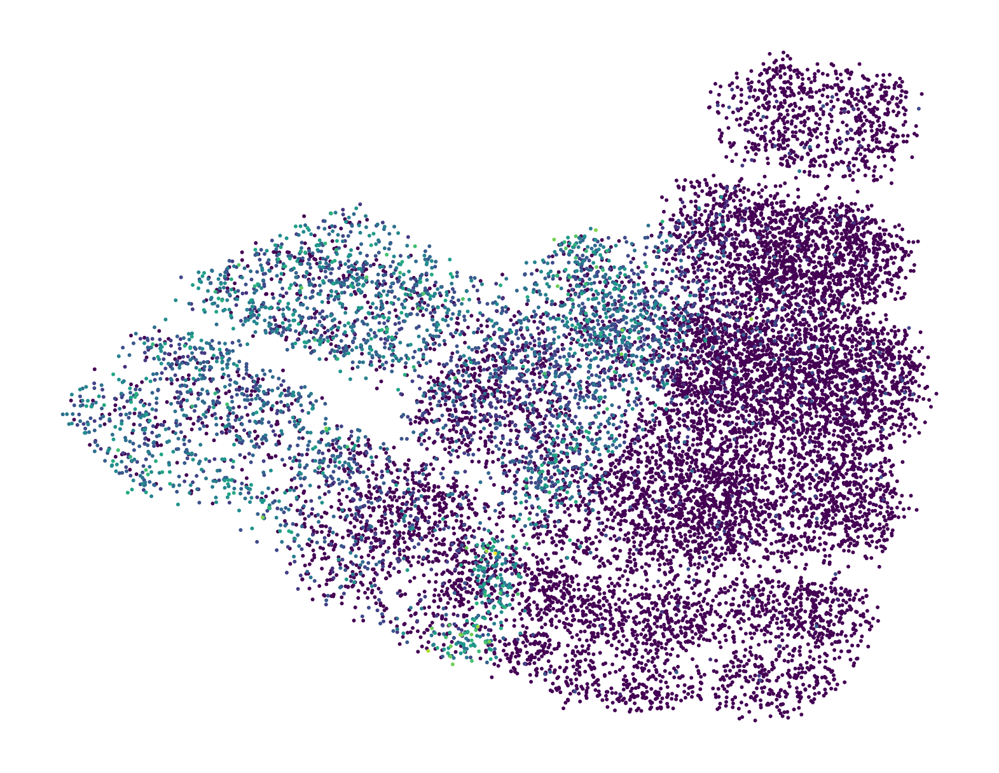

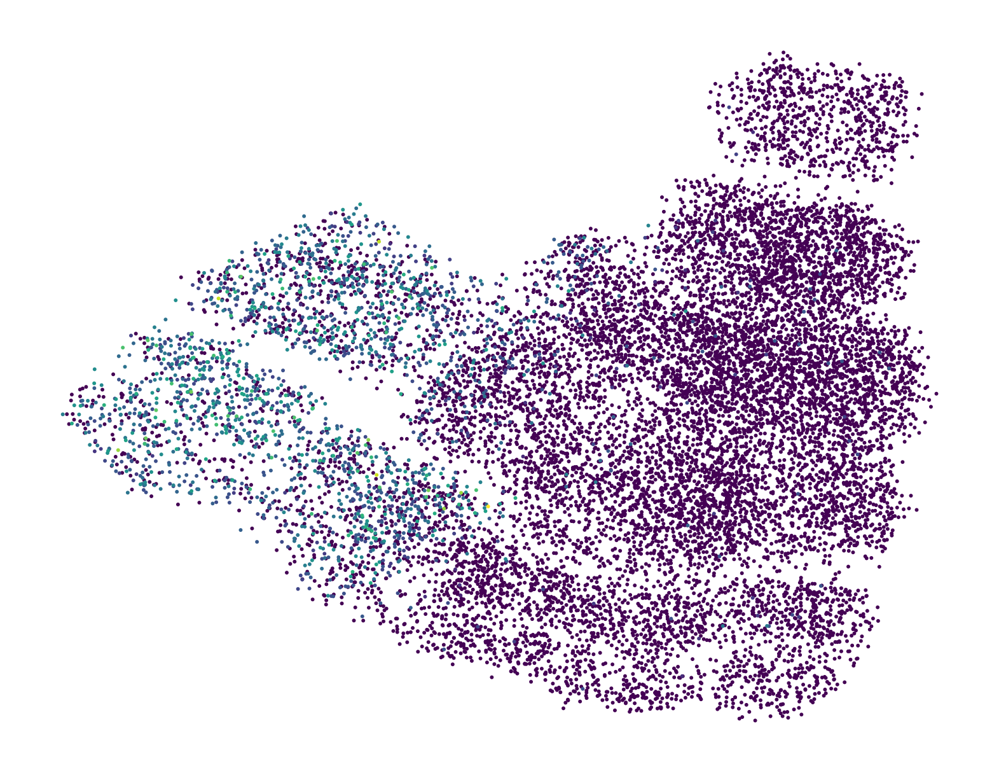

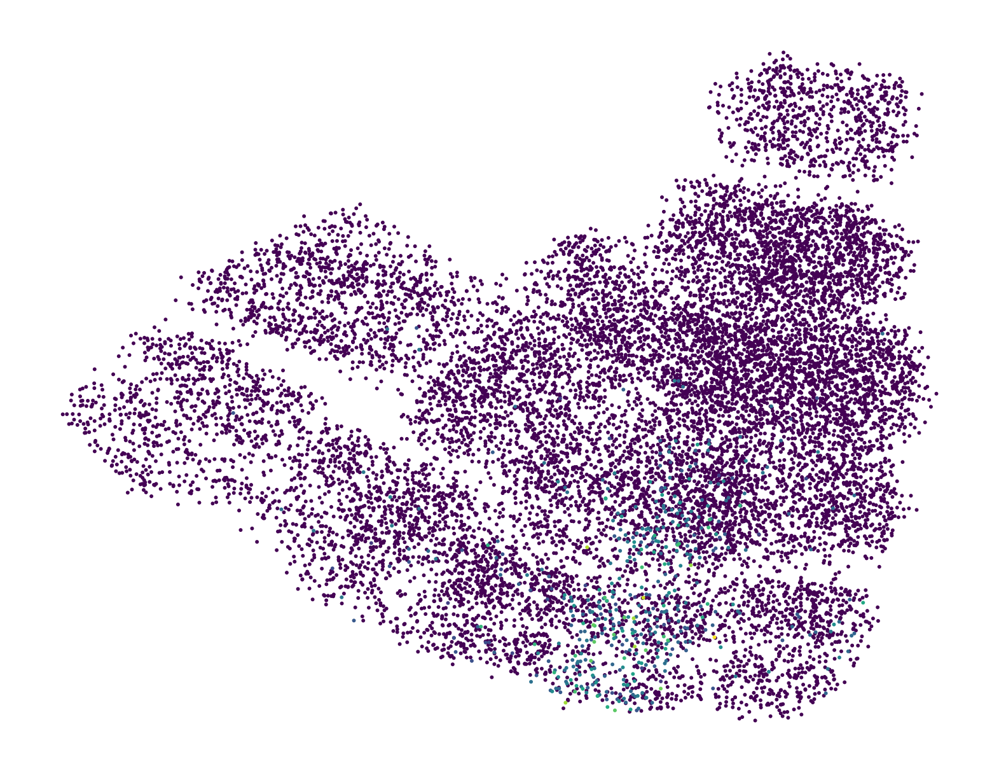

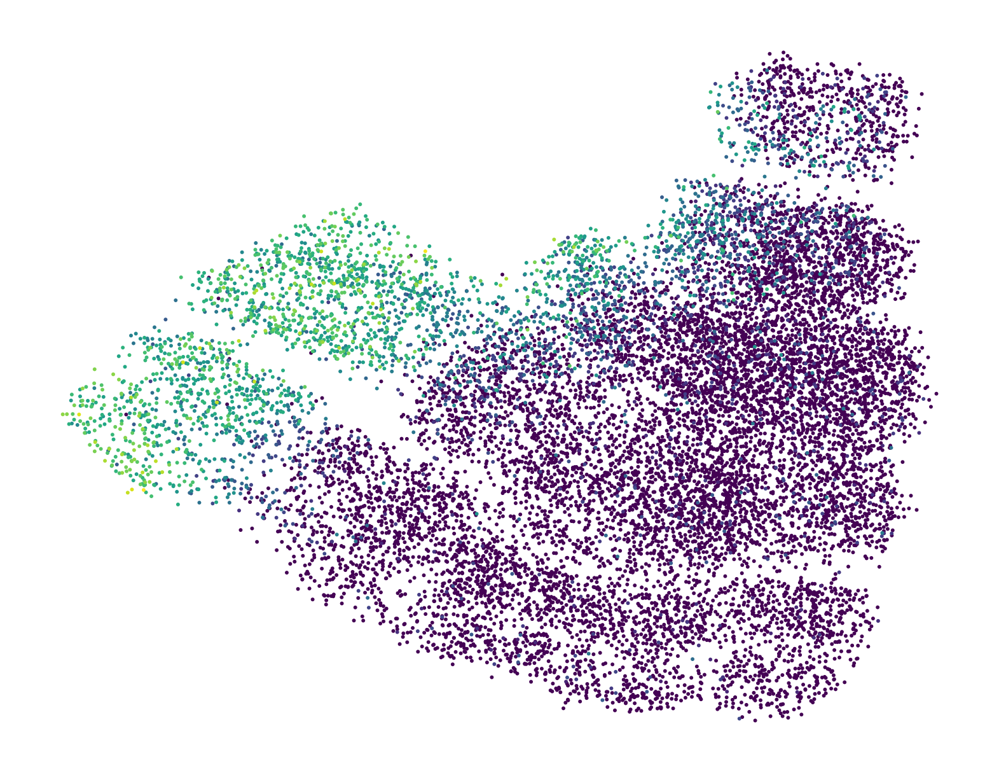

...

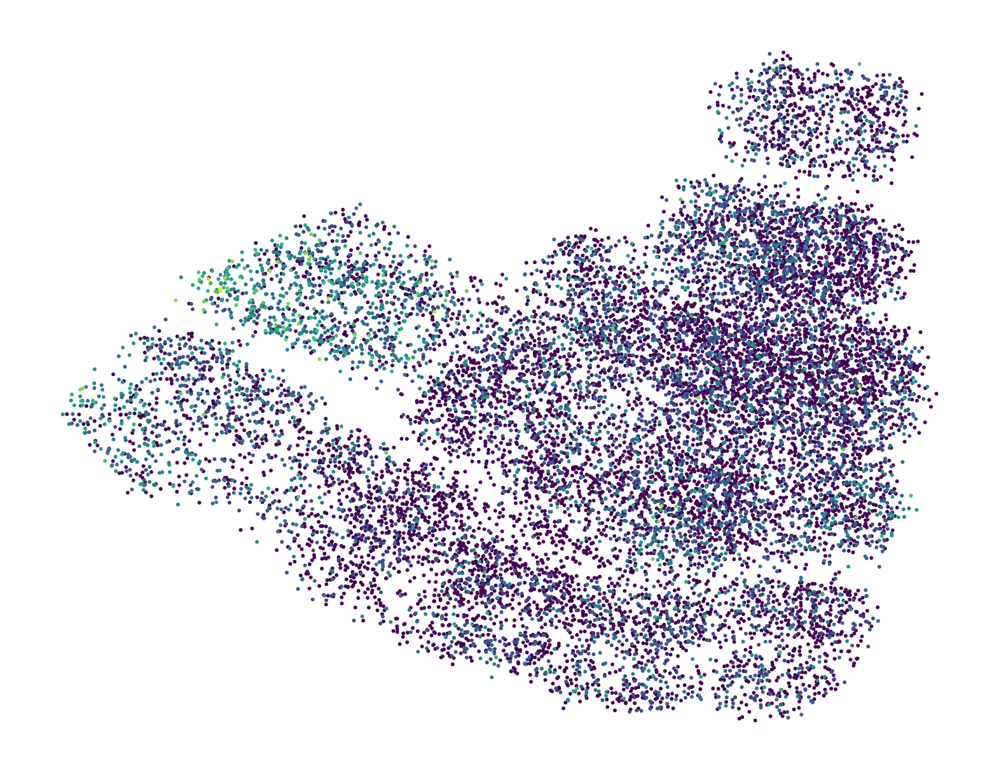

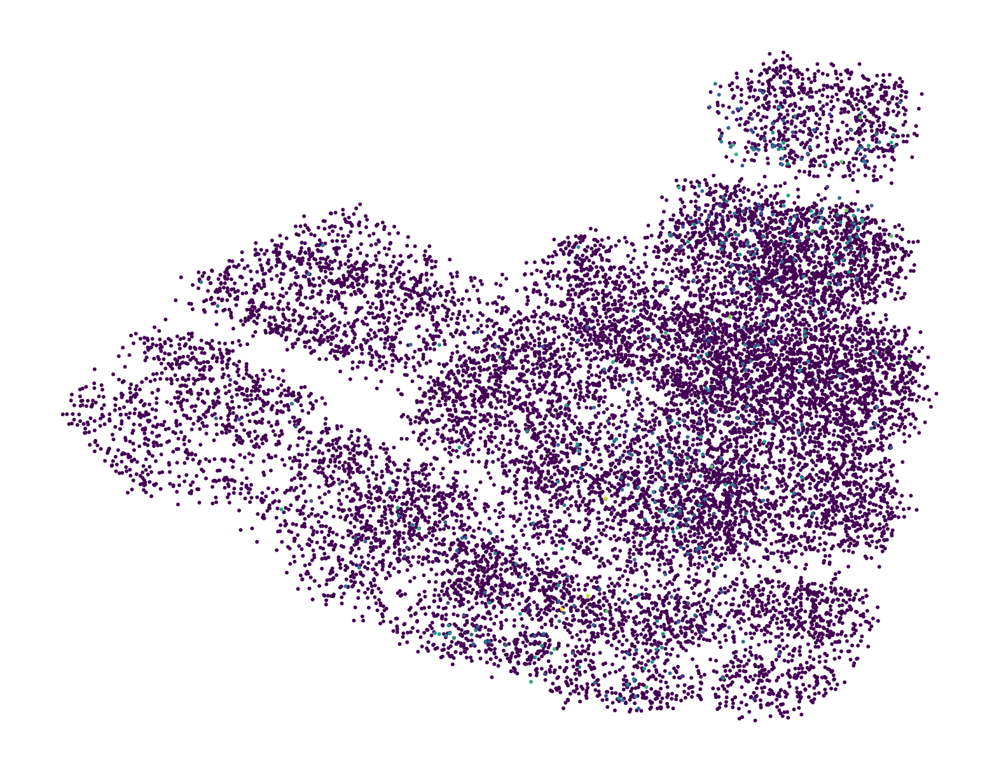

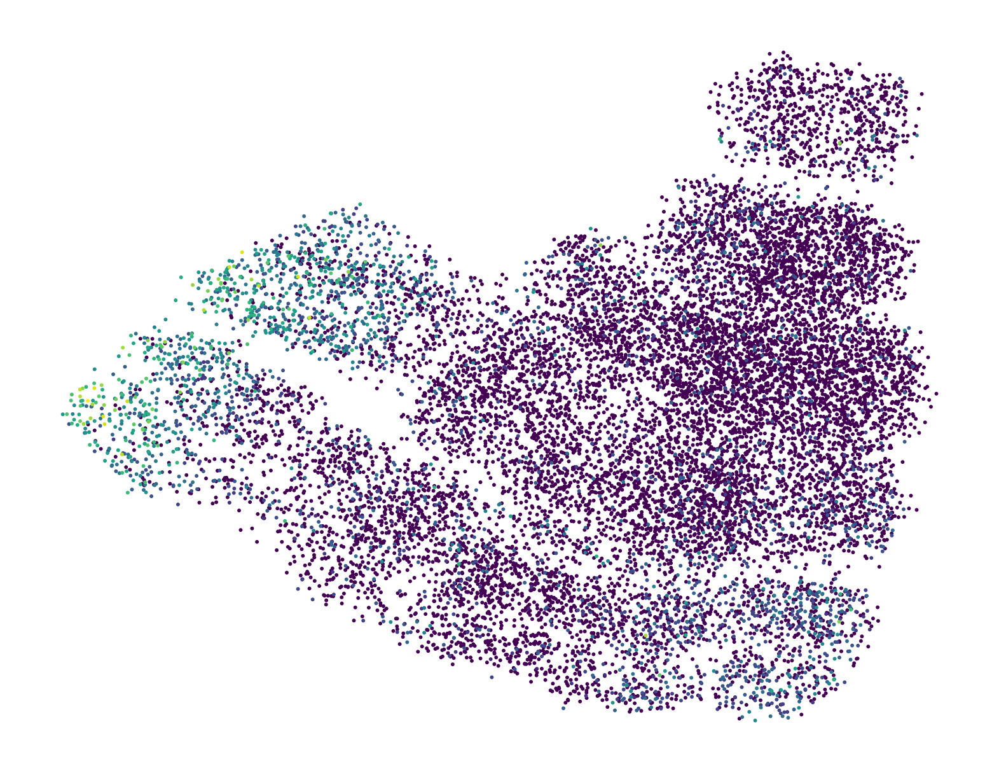

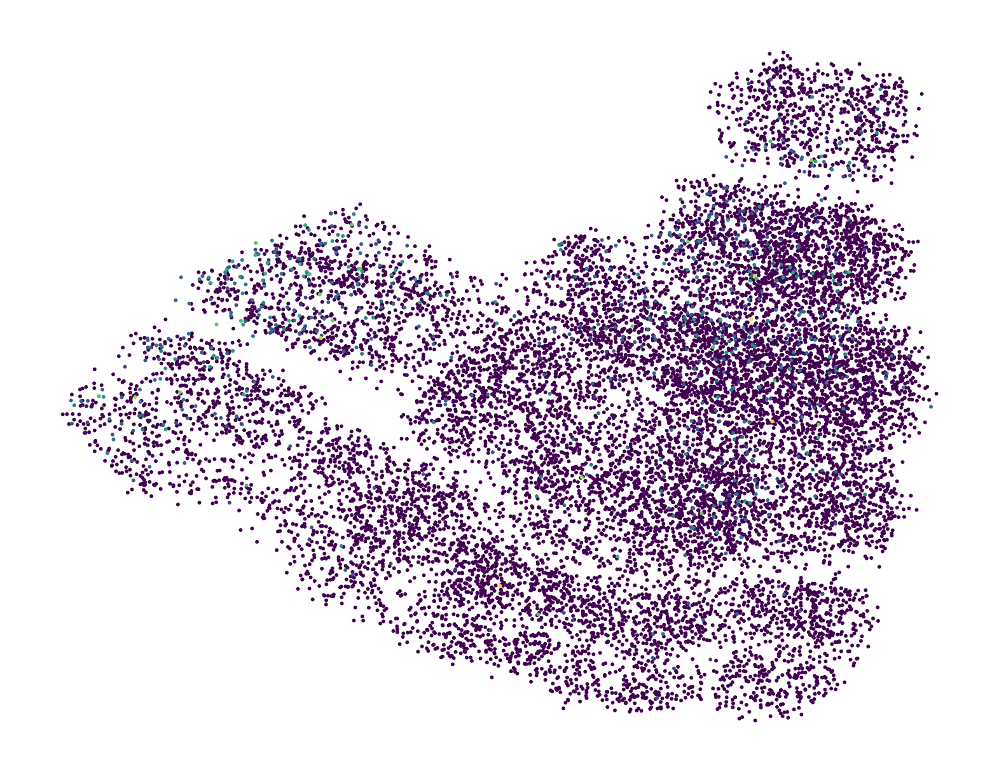

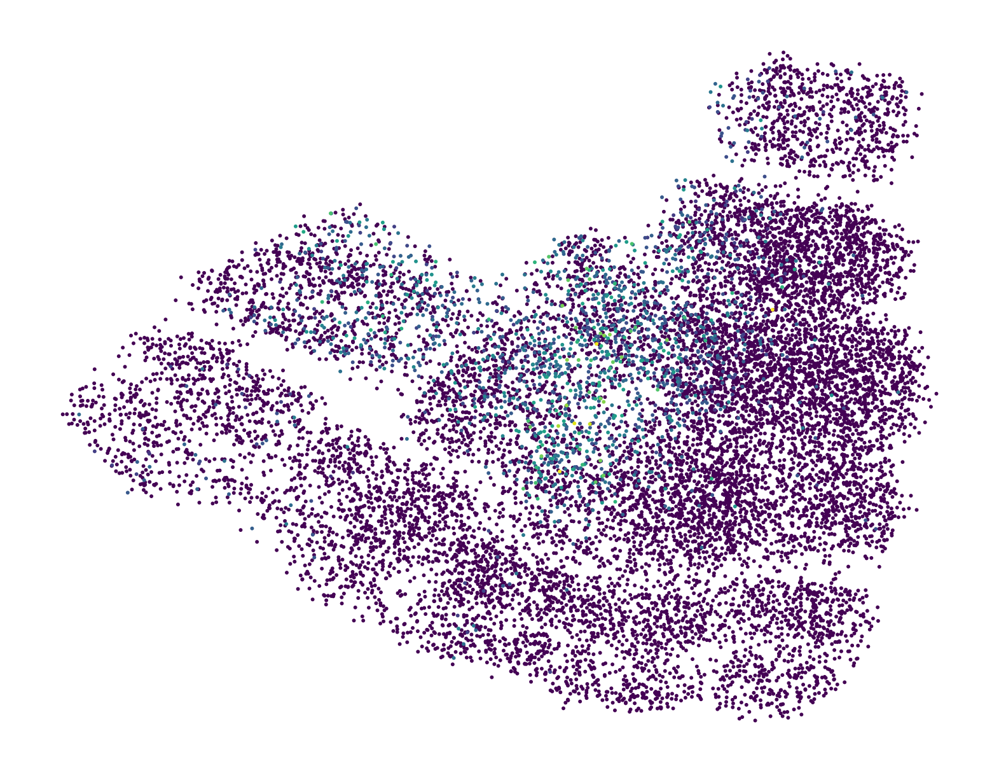

In [10]:
sc.settings.figdir = base_dir / "APmicropatterns"
markers = ["OTX2","HOXB1","HOXB4","PAX5","CDX2","POU5F1","CDH1","CDH2","LEF1","WNT3","WNT5B","WNT6","WNT8A"]
#vmax_value=list([2,2,1.75,1.2,2.5,None,None,None,1.0,1.5])
for index, marker in enumerate(markers):  
    fig, ax = plt.subplots(figsize=(6.5, 5), dpi=300)
    sc.pl.umap(adata, 
               color=marker,
               save=f'-{marker}.png',
               frameon=False,
               title='',
               colorbar_loc=None,
               ax=ax)

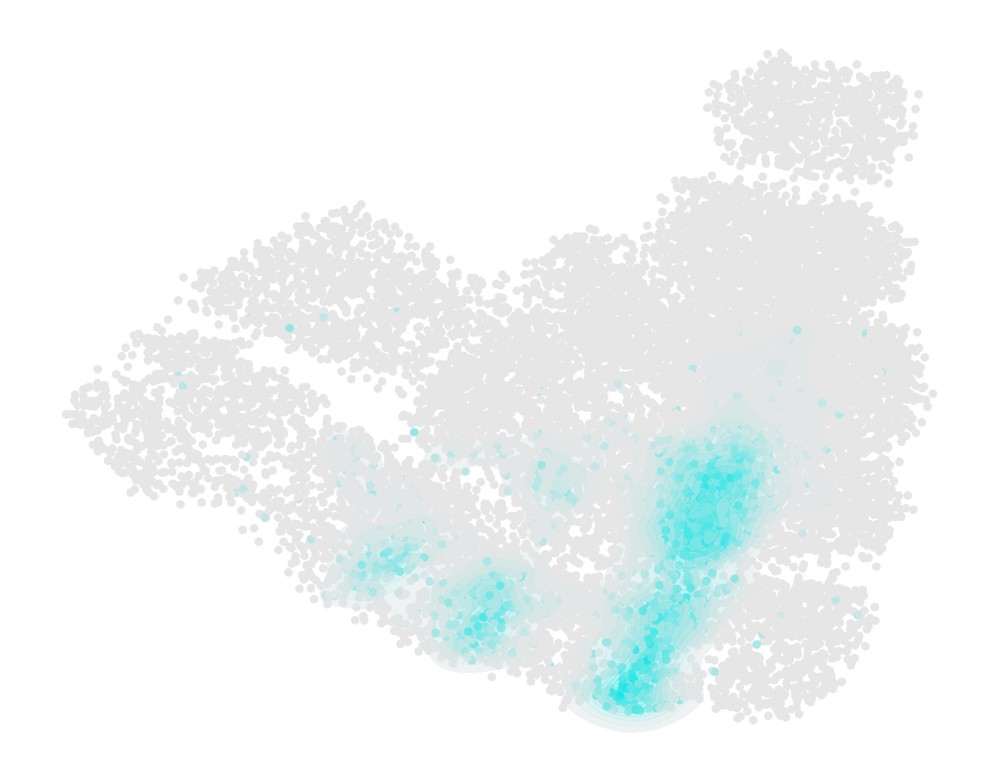

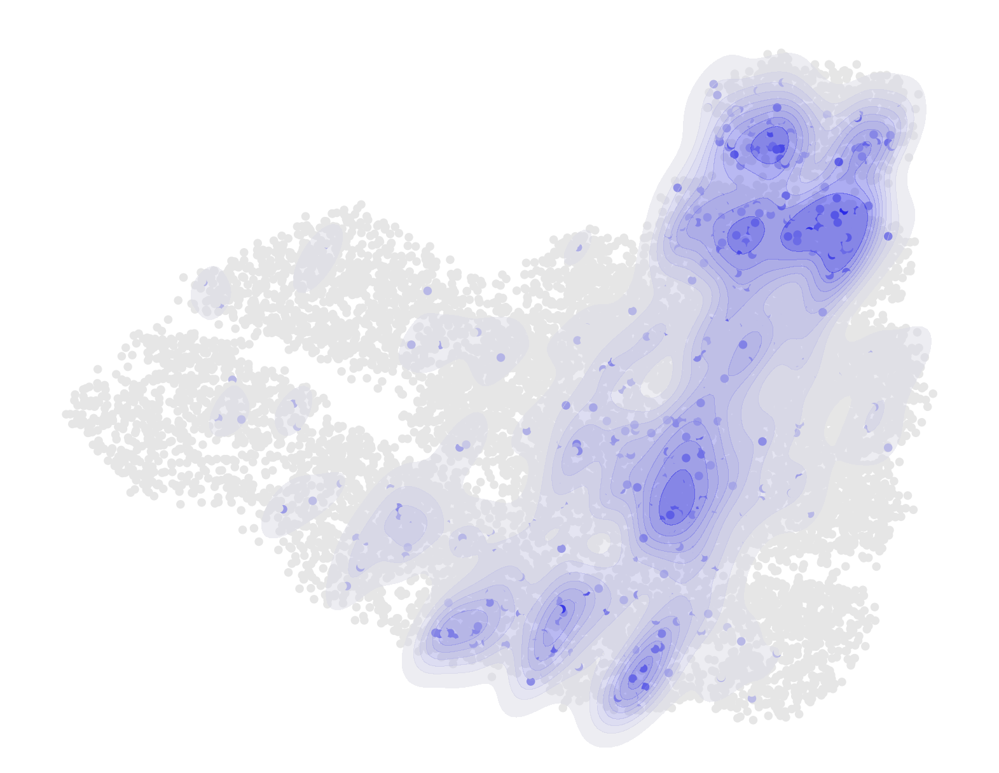

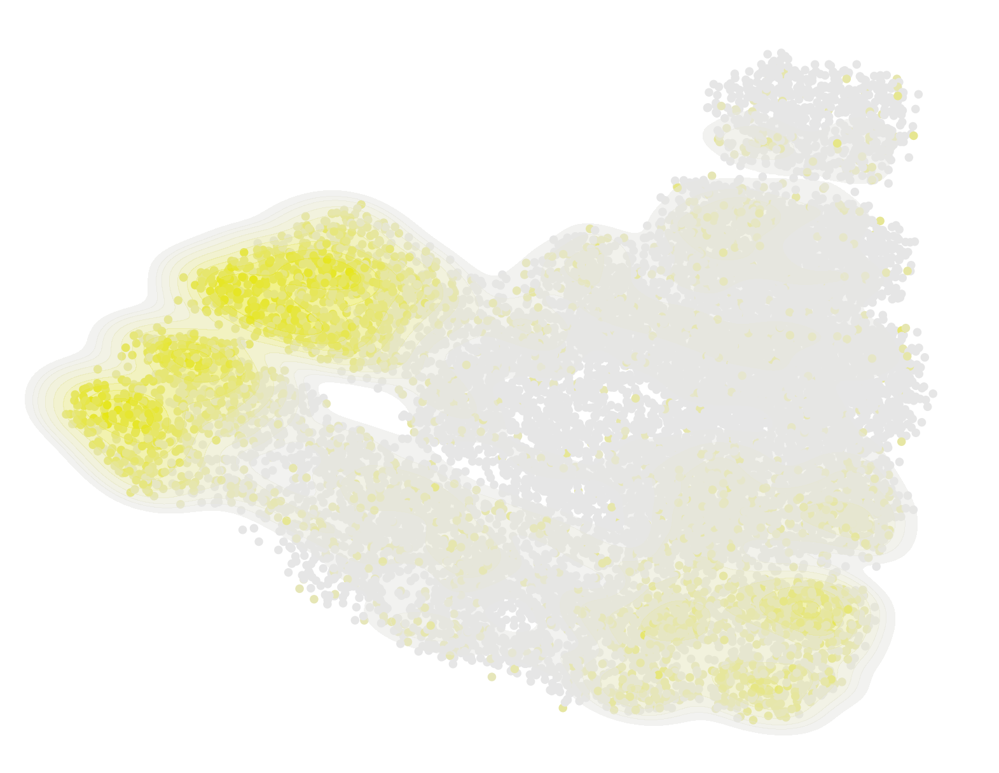

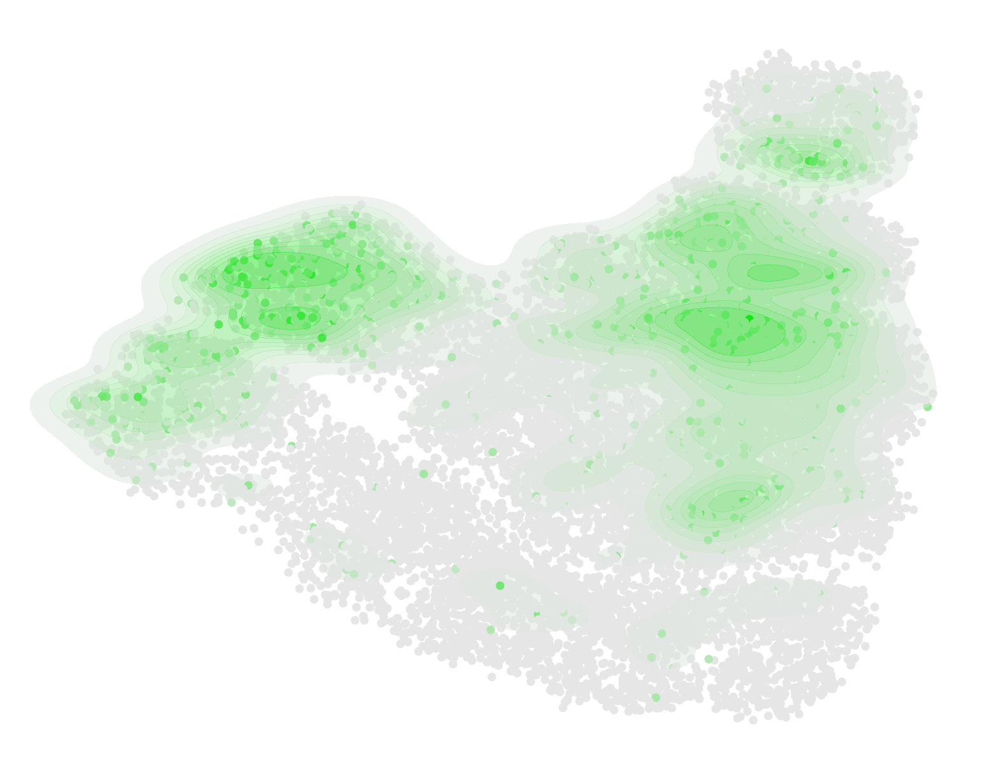

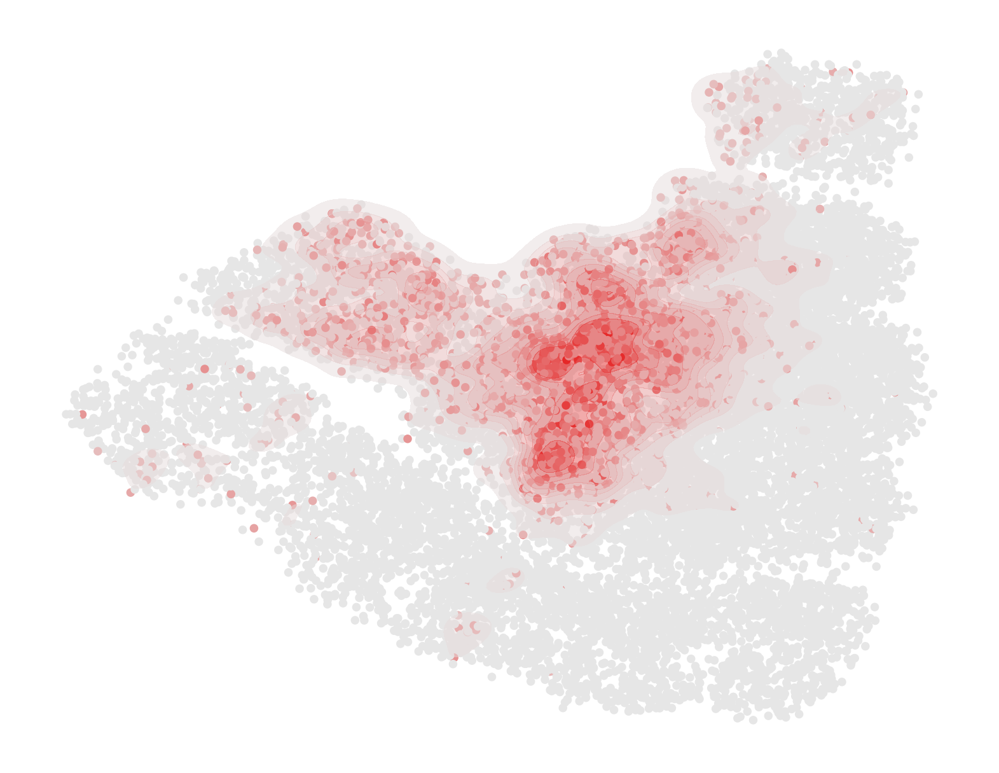

In [11]:
def normalize(d,p=1.25):
    d = np.power(d, p)
    return (d-np.min(d))/(np.max(d)-np.min(d))

def plot_kde_on_umap(adata,gene_name,cm,title_name,p=1.25):
    umap_coords = adata.obsm['X_umap']
    x_coords = umap_coords[:, 0]
    y_coords = umap_coords[:, 1]

    goi_value = normalize(adata.X[:, adata.var_names.get_loc(gene_name)].toarray(),p).flatten()
    colors = [cm(l) for l in goi_value]

    fig, ax = plt.subplots(figsize=(6.5, 5), dpi=300)
    plt.scatter(x_coords, y_coords, c = colors, s = 5.)
    sns.kdeplot(ax =ax, x = x_coords, y = y_coords, weights = goi_value, fill=True, bw_adjust=0.4, cmap=cm, alpha=0.5)
    plt.axis('off')
    fig.savefig(base_dir / f"APmicropatterns/kde-{title_name}.png")
    fig.savefig(base_dir / f"APmicropatterns/kde-{title_name}.svg")


umap_coords = adata.obsm['X_umap']
x_coords = umap_coords[:, 0]
y_coords = umap_coords[:, 1]

# Wnt1 kdeplot
gene_name = "WNT1"
values = [np.power(t / 100., 1) for t in range(100)]
colors = [[0.9*(1-t),0.9,0.9] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_kde_on_umap(adata, gene_name, cm, gene_name, 1)

# Wnt3 kdeplot
gene_name = "WNT3"
values = [np.power(t / 100., 1) for t in range(100)]
colors = [[0.9*(1-t),0.9*(1-t),0.9] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_kde_on_umap(adata, gene_name, cm, gene_name, 1)

# Wnt5b kdeplot
gene_name = "WNT5B"
values = [np.power(t / 100., 1) for t in range(100)]
colors = [[0.9,0.9,0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_kde_on_umap(adata, gene_name, cm, gene_name, 1)

# Wnt6 kdeplot
gene_name = "WNT6"
values = [np.power(t / 100., 1) for t in range(100)]
colors = [[0.9*(1-t),0.9,0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_kde_on_umap(adata, gene_name, cm, gene_name, 1)

# Wnt8a kdeplot
gene_name = "WNT8A"
values = [np.power(t / 100., 1) for t in range(100)]
colors = [[0.9,0.9*(1-t),0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_kde_on_umap(adata, gene_name, cm, gene_name, 1)

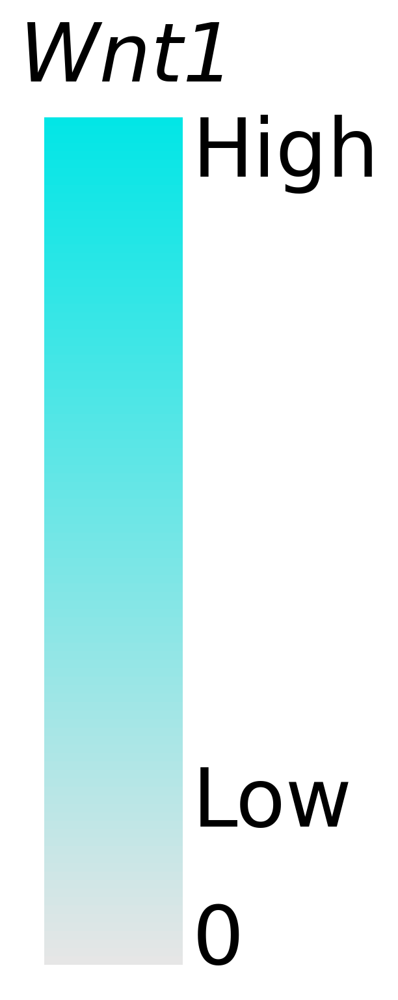

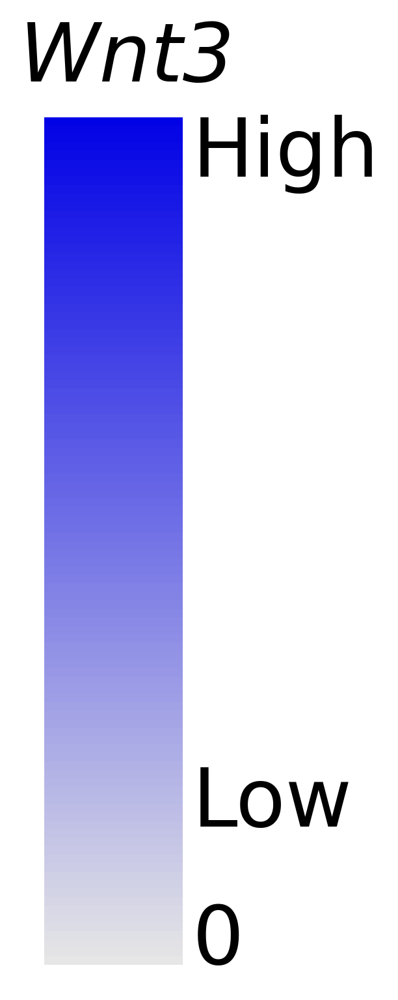

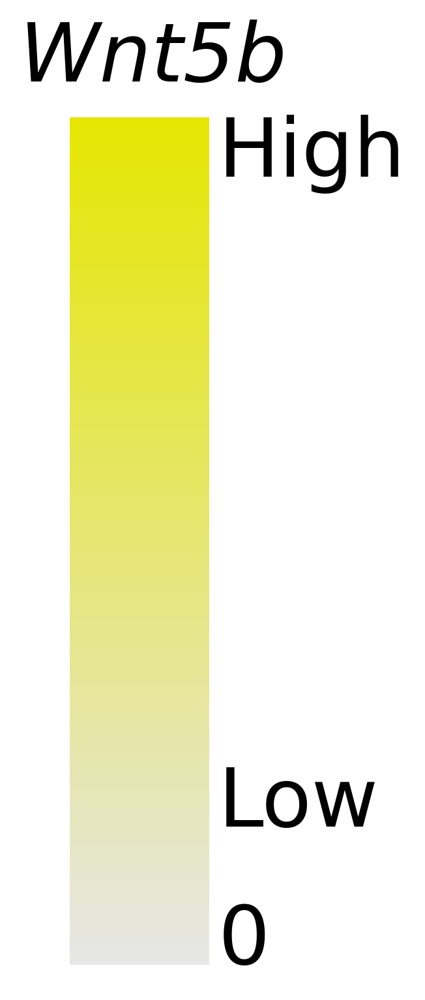

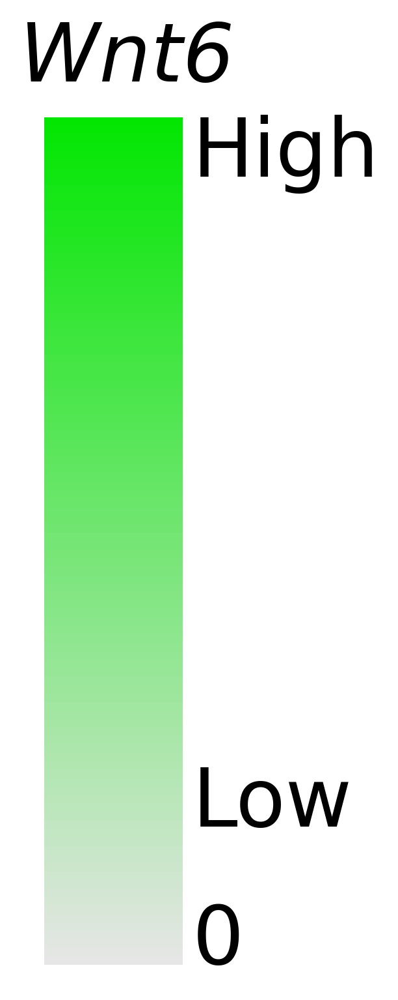

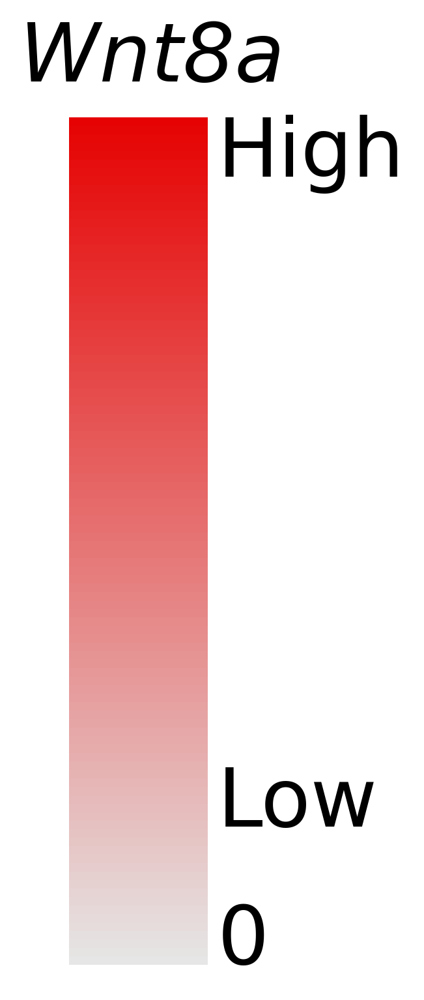

In [12]:
def plot_colorbar(gene_name,cm):
    fig, ax = plt.subplots(figsize=(1.8, 5), layout='constrained', dpi=300)
    fig.suptitle(gene_name.capitalize(), fontsize=30, x=0.26, style='italic')
    
    cmap = cm
    norm = mpl.colors.Normalize(vmin=0, vmax=1)
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
                        cax=ax, orientation='vertical', 
                        label='', 
                        ticks=[0.038, 0.2, 0.967],  
                        format=mpl.ticker.FixedFormatter(['0', 'Low', 'High']))
    ax.tick_params('y', labelsize=30)
    cbar.set_label('', fontsize=0)
    cbar.ax.yaxis.set_label_position('left')
    cbar.outline.set_visible(False)
    cbar.ax.tick_params(length=0)

    fig.savefig(base_dir / f"APmicropatterns/colorbar-{gene_name}.png",bbox_inches='tight')
    #fig.savefig(base_dir / f"APaxisFGF/colorbar-{gene_name}.svg",bbox_inches='tight')

# Wnt1
gene_name = "WNT1"
values = [np.pow(t / 100., 1) for t in range(100)]
colors = [[0.9*(1-t),0.9,0.9] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)

# Wnt3
gene_name = "WNT3"
values = [np.pow(t / 100., 1) for t in range(100)]
colors = [[0.9*(1-t),0.9*(1-t),0.9] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)

# Wnt5b
gene_name = "WNT5B"
values = [np.pow(t / 100., 1) for t in range(100)]
colors = [[0.9,0.9,0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)

# Wnt6
gene_name = "WNT6"
values = [np.pow(t / 100., 1) for t in range(100)]
colors = [[0.9*(1-t),0.9,0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)

# Wnt8a
gene_name = "WNT8A"
values = [np.pow(t / 100., 1) for t in range(100)]
colors = [[0.9,0.9*(1-t),0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)

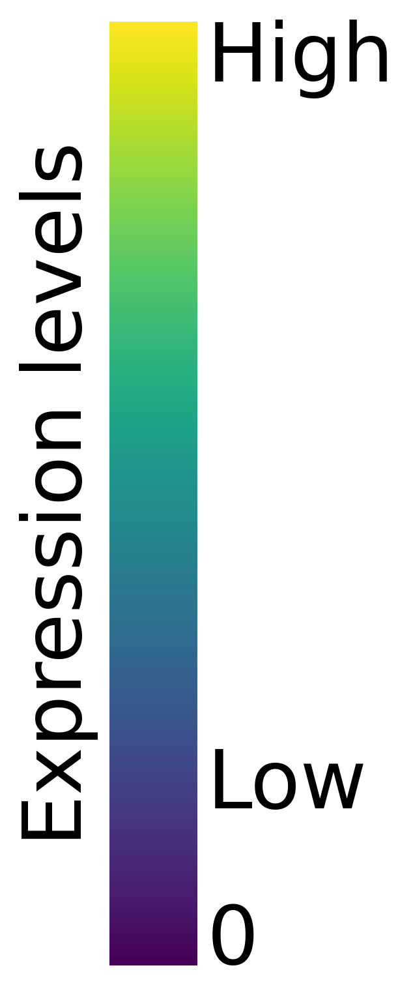

In [13]:
# colorbar plot
fig, ax = plt.subplots(figsize=(2, 5), layout='constrained', dpi=300)

cmap = mpl.cm.viridis
norm = mpl.colors.Normalize(vmin=0, vmax=1)
cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
             cax=ax, orientation='vertical', 
             label='Expression levels', 
             ticks=[0.035, 0.2, 0.97], 
             format=mpl.ticker.FixedFormatter(['0', 'Low', 'High']))
ax.tick_params('y', labelsize=30)
cbar.set_label('Expression levels', fontsize=30)
cbar.ax.yaxis.set_label_position('left')
cbar.outline.set_visible(False)
cbar.ax.tick_params(length=0)

fig.savefig(base_dir / "APmicropatterns/colorbar.png")
#fig.savefig(base_dir / "APmicropatterns/colorbar.svg")

## Plot with 2 cell groups

In [14]:
# import saved scvi normalized data for only fb, mb, hb, sc
saved_file = base_dir / "Pijuan-Sala2019_mouse_atlas/data/scvi_v2_neural_ap2.hda5"
adata2 = anndata.read_h5ad(saved_file)

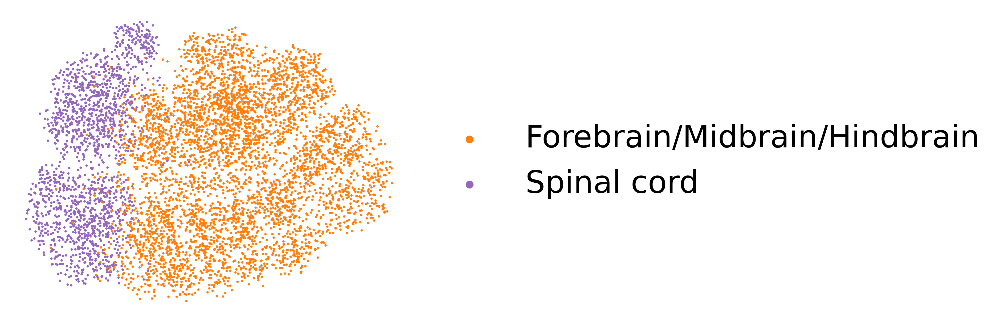

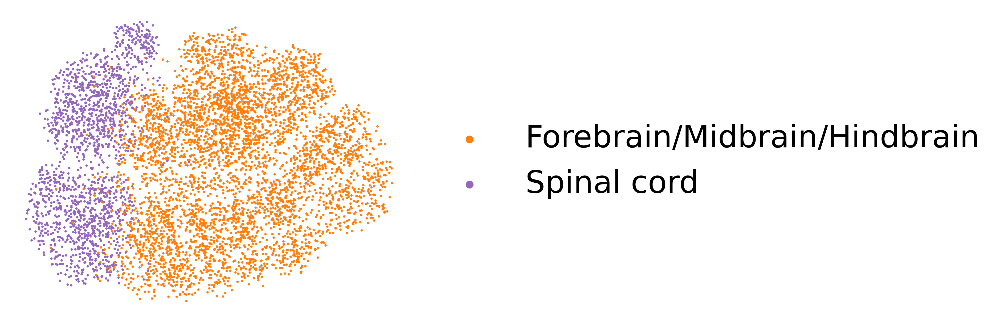

In [15]:
# umap plot - celltype and stage
sc.tl.umap(adata2,spread=0.5,min_dist=0.8)
adata2.obsm["X_umap"][:, 0] *= -1 # flip X axis
adata2.obsm["X_umap"][:, 1] *= -1 # flip X axis
adata2.uns["celltype_colors"] = ["#ff7f0e","#9467bd"]
sc.settings.figdir = base_dir / "APmicropatterns"
fig, ax = plt.subplots(figsize=(6.5, 5), dpi=300)
sc.pl.umap(adata2,color="celltype",
           title="",
           legend_fontsize=28,
           save="-celltype-2.png",
           frameon=False,
           ax=ax)

fig, ax = plt.subplots(figsize=(6.5, 5), dpi=300)
sc.pl.umap(adata2,color="celltype",
           title="",
           legend_fontsize=28,
           save="-celltype-2.svg",
           frameon=False,
           ax=ax)

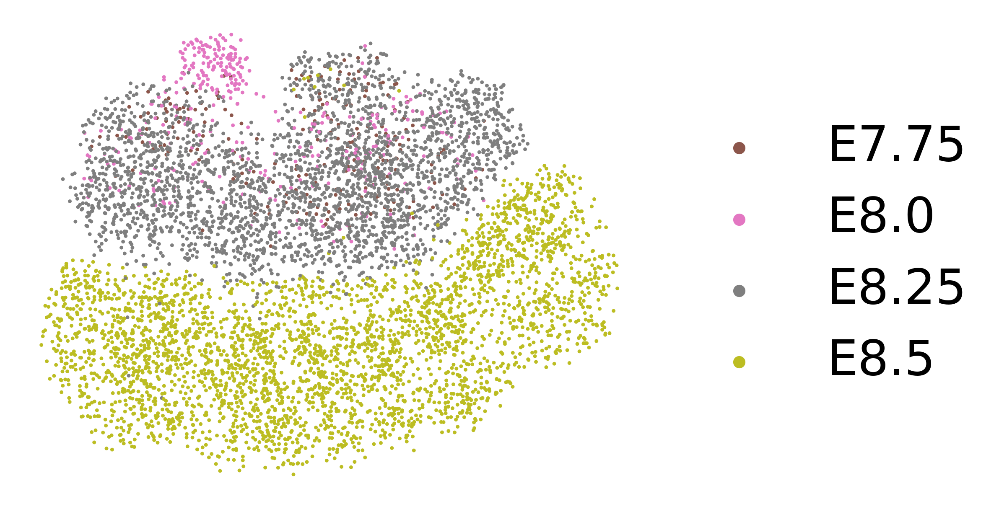

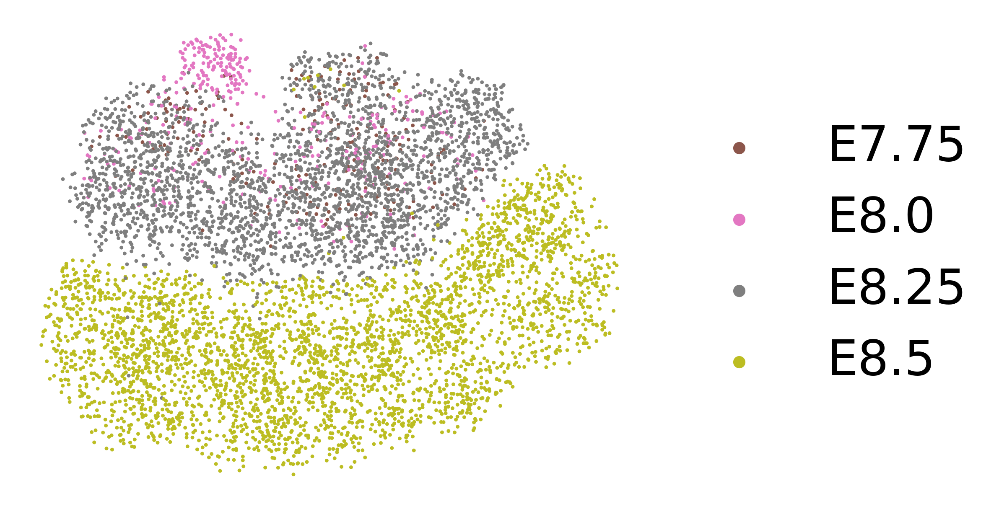

In [16]:
stages = ["E7.75","E8.0","E8.25","E8.5"]
adata2.obs["stages_ordered"] = pd.Categorical(
    values=adata2.obs["stage"], categories=stages, ordered=True
)
adata2.uns["stages_ordered_colors"] = ["#8c564b","#e377c2","#7f7f7f","#bcbd22"]
fig, ax = plt.subplots(figsize=(6.5, 5), dpi=300)
sc.pl.umap(adata2,color="stages_ordered",
           title="",
           legend_fontsize=28,
           save="-stage-2.png",
           frameon=False,
           ax=ax)

fig, ax = plt.subplots(figsize=(6.5, 5), dpi=300)
sc.pl.umap(adata2,color="stages_ordered",
           title="",
           legend_fontsize=28,
           save="-stage-2.svg",
           frameon=False,
           ax=ax)

In [17]:
# plot Fgf8 and Wnt1 expression in the same umap plot
umap_coords = adata2.obsm['X_umap']
x_coords = umap_coords[:, 0]
y_coords = umap_coords[:, 1]

def normalize(d):
    return (d-np.min(d))/(np.max(d)-np.min(d)) 

fgf_value = normalize(adata2.X[:, adata2.var_names.get_loc('FGF8')].toarray()).flatten()
wnt_value = normalize(adata2.X[:, adata2.var_names.get_loc('WNT1')].toarray()).flatten()

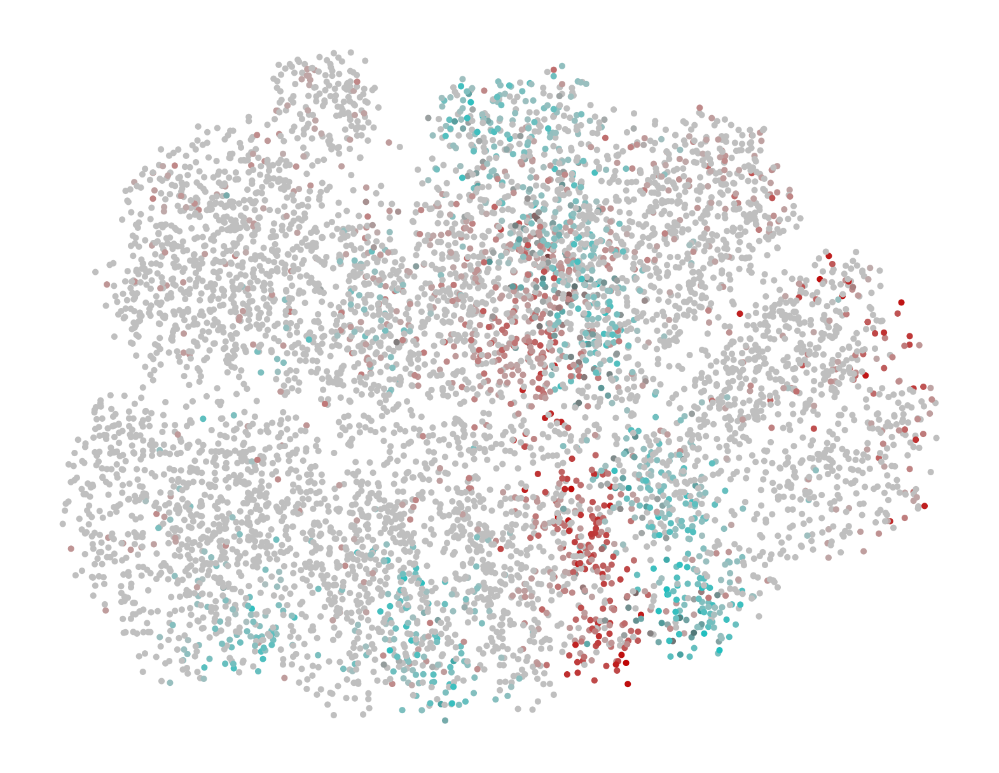

In [18]:
colors = [(0.75*(1-w), 0.75*(1-f), 0.75*(1-f)) for w, f in zip(wnt_value, fgf_value)]

fig, ax = plt.subplots(figsize=(6.5, 5), dpi=300)
plt.scatter(x_coords, y_coords, c = colors, s = 2.)
plt.axis('off')
fig.savefig(base_dir / "APmicropatterns/WNT1-FGF8.png")
fig.savefig(base_dir / "APmicropatterns/WNT1-FGF8.svg")

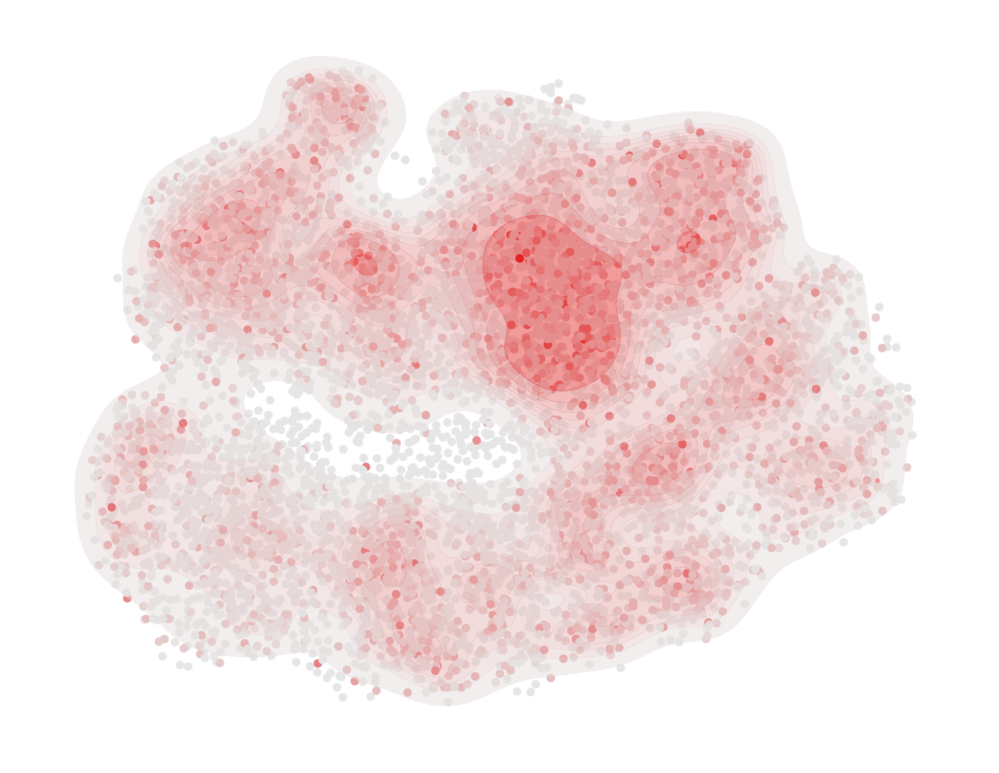

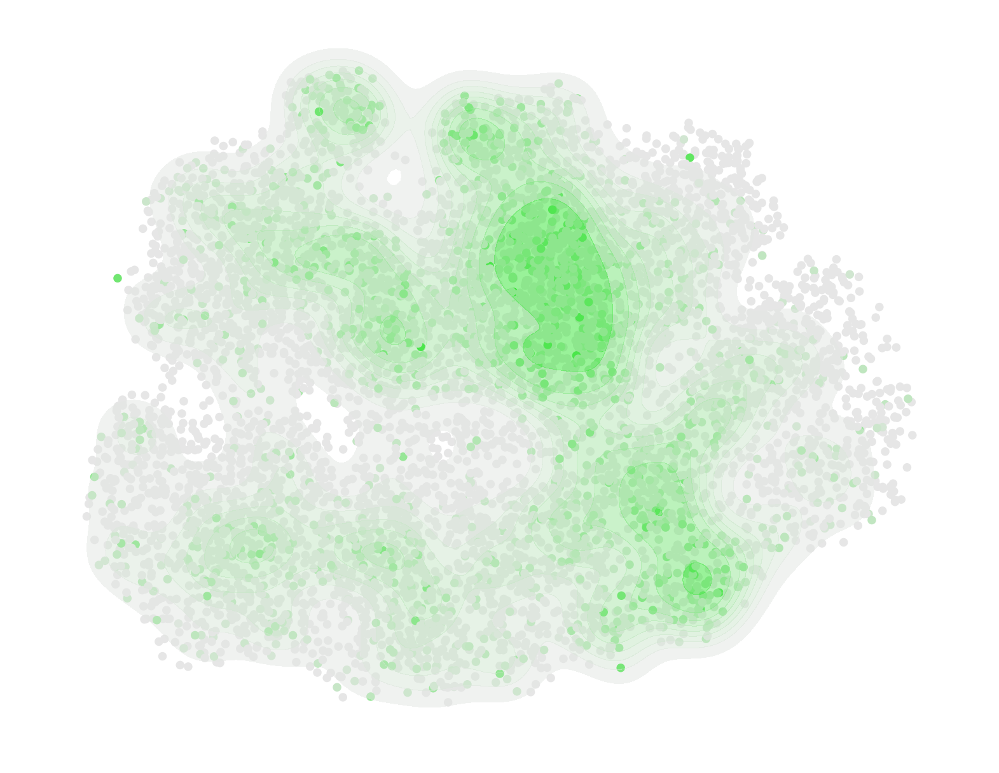

In [19]:
def normalize(d,p=1.25):
    d = np.power(d, p)
    return (d-np.min(d))/(np.max(d)-np.min(d))

def plot_kde_on_umap(adata,gene_name,cm,title_name,p=1.25):
    umap_coords = adata.obsm['X_umap']
    x_coords = umap_coords[:, 0]
    y_coords = umap_coords[:, 1]

    goi_value = normalize(adata.X[:, adata.var_names.get_loc(gene_name)].toarray(),p).flatten()
    colors = [cm(l) for l in goi_value]

    fig, ax = plt.subplots(figsize=(6.5, 5), dpi=300)
    plt.scatter(x_coords, y_coords, c = colors, s = 5.)
    sns.kdeplot(ax =ax, x = x_coords, y = y_coords, weights = goi_value, fill=True, bw_adjust=0.5, cmap=cm, alpha=0.5)
    plt.axis('off')
    fig.savefig(base_dir / f"APmicropatterns/kde-{title_name}.png")
    fig.savefig(base_dir / f"APmicropatterns/kde-{title_name}.svg")


umap_coords = adata2.obsm['X_umap']
x_coords = umap_coords[:, 0]
y_coords = umap_coords[:, 1]

# Lef1 kdeplot
gene_name = "LEF1"
values = [np.power(t / 100., 1.25) for t in range(100)]
colors = [[0.9,0.9*(1-t),0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_kde_on_umap(adata2, gene_name, cm, gene_name+"-2")

# Axin2 kdeplot
gene_name = "AXIN2"
values = [np.power(t / 100., 1.25) for t in range(100)]
colors = [[0.9*(1-t),0.9,0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_kde_on_umap(adata2, gene_name, cm, gene_name+"-2")

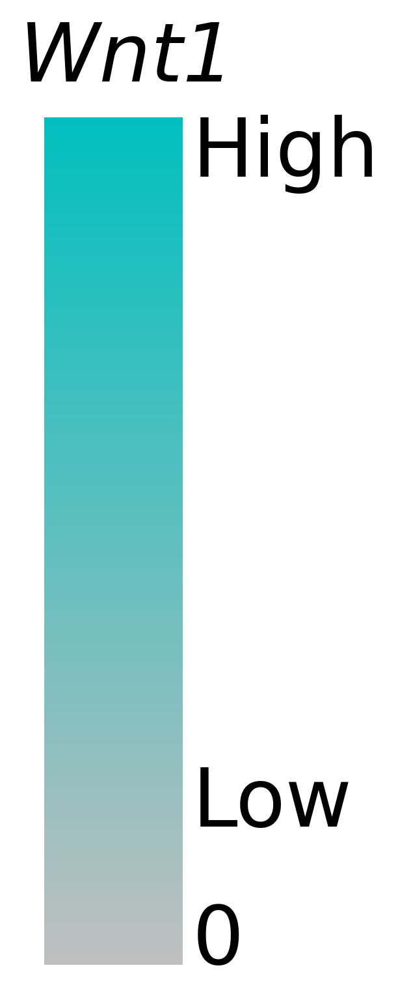

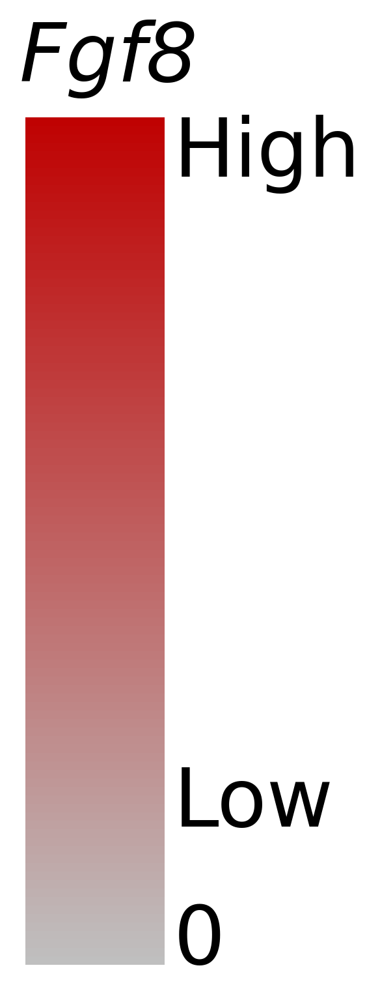

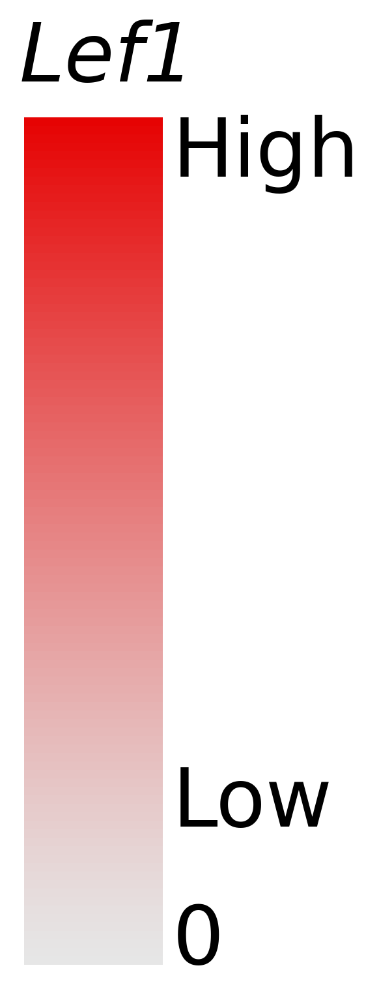

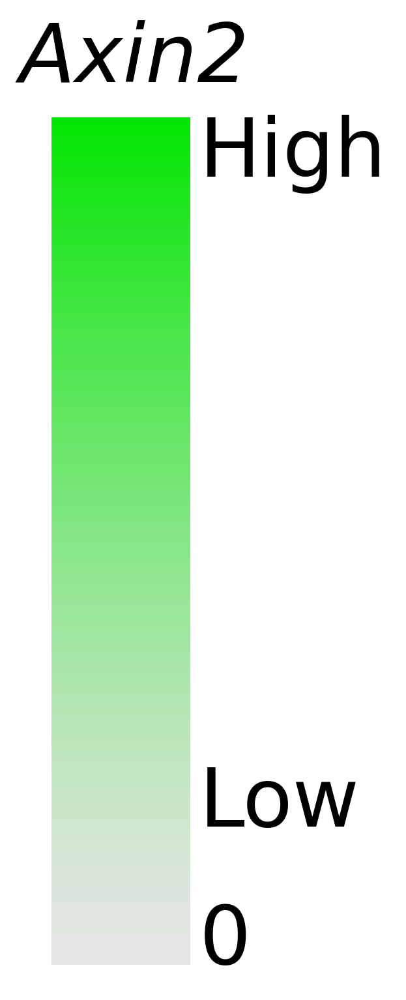

In [20]:
def plot_colorbar(gene_name,cm):
    fig, ax = plt.subplots(figsize=(1.8, 5), layout='constrained', dpi=300)
    fig.suptitle(gene_name.capitalize(), fontsize=30, x=0.26, style='italic')
    
    cmap = cm
    norm = mpl.colors.Normalize(vmin=0, vmax=1)
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
                        cax=ax, orientation='vertical', 
                        label='', 
                        ticks=[0.038, 0.2, 0.967],  
                        format=mpl.ticker.FixedFormatter(['0', 'Low', 'High']))
    ax.tick_params('y', labelsize=30)
    cbar.set_label('', fontsize=0)
    cbar.ax.yaxis.set_label_position('left')
    cbar.outline.set_visible(False)
    cbar.ax.tick_params(length=0)

    fig.savefig(base_dir / f"APmicropatterns/colorbar-{gene_name}-2.png",bbox_inches='tight')
    #fig.savefig(base_dir / f"APaxisFGF/colorbar-{gene_name}.svg",bbox_inches='tight')

# Wnt1
gene_name = "WNT1"
values = [np.pow(t / 100., 1) for t in range(100)]
colors = [[0.75*(1-t),0.75,0.75] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)

# Fgf8
gene_name = "FGF8"
values = [np.pow(t / 100., 1) for t in range(100)]
colors = [[0.75,0.75*(1-t),0.75*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)

# Lef1
gene_name = "LEF1"
values = [np.pow(t / 100., 1.25) for t in range(100)]
colors = [[0.9,0.9*(1-t),0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)

# Axin2
gene_name = "AXIN2"
values = [np.pow(t / 100., 1.25) for t in range(100)]
colors = [[0.9*(1-t), 0.9,0.9*(1-t)] for t in values]
cm = mcolors.LinearSegmentedColormap.from_list(gene_name, colors, N=100)
plot_colorbar(gene_name, cm)